## Auto Accidents Analysis - Grand Rapids, Michigan, USA

**Author:** Guilherme Cadori

**Date:** 12/04/2024


### Study Objective

Our primary goal with this analysis is to understand some of the factors associated with auto accidents to improve risk assessment and to investigate elements that could impact pricing and model underwriting. 

By addressing these questions, we can develop more precise underwriting and tailored insurance products, improve claims management and promote safer driving practices.

### Points to consider:

**Main Question:** Based on the crash data, how are crashes changing over time?

**Support Topics**

1) Trends in acciident frequency and severity over time
    - Reason: Directly addresses the primary question asked in the assessment.
    - Value: Provides foundational insights and is essential for understanding overall patterns.

2) Driver demographics and risk profiles (sex, age, others)
    - Reason: Critical for insurance companies to assess risk and tailor products.
    - Value: Can reveal high-risk groups and inform underwriting policies.

3) Geographic distribution of crashes
    - Reason: Offers insights into location-based risks.

4) Predictive Modeling: severe accident propensity profiles


### Data Exploration 

#### Loading Libraries and Data

In [1]:
# Loading support libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import HeatMap
from datetime import datetime

# Data preparation
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.impute import SimpleImputer

# Feature encoding
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder

# Model development
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier

# Model evaluation
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, roc_curve

# Displays all columns
pd.set_option('display.max_columns', None)

In [2]:
# Loading Data
crashes_df = pd.read_csv('C:/Guilherme/analysis_data/TrafficCrashes_20241203.csv')
people_df = pd.read_csv('C:/Guilherme/analysis_data/TrafficCrashesPeople_20241203.csv')


C:\Users\gccad\AppData\Local\Temp\ipykernel_29584\3958417540.py:3: DtypeWarning: Columns (19,23,24,25,28) have mixed types. Specify dtype option on import or set low_memory=False.
  people_df = pd.read_csv('C:/Guilherme/analysis_data/TrafficCrashesPeople_20241203.csv')


In [3]:
crashes_df.head(4)

,CRASH_RECORD_ID,CRASH_DATE_EST_I,CRASH_DATE,POSTED_SPEED_LIMIT,TRAFFIC_CONTROL_DEVICE,DEVICE_CONDITION,WEATHER_CONDITION,LIGHTING_CONDITION,FIRST_CRASH_TYPE,TRAFFICWAY_TYPE,LANE_CNT,ALIGNMENT,ROADWAY_SURFACE_COND,ROAD_DEFECT,REPORT_TYPE,CRASH_TYPE,INTERSECTION_RELATED_I,NOT_RIGHT_OF_WAY_I,HIT_AND_RUN_I,DAMAGE,DATE_POLICE_NOTIFIED,PRIM_CONTRIBUTORY_CAUSE,SEC_CONTRIBUTORY_CAUSE,STREET_NO,STREET_DIRECTION,STREET_NAME,BEAT_OF_OCCURRENCE,PHOTOS_TAKEN_I,STATEMENTS_TAKEN_I,DOORING_I,WORK_ZONE_I,WORK_ZONE_TYPE,WORKERS_PRESENT_I,NUM_UNITS,MOST_SEVERE_INJURY,INJURIES_TOTAL,INJURIES_FATAL,INJURIES_INCAPACITATING,INJURIES_NON_INCAPACITATING,INJURIES_REPORTED_NOT_EVIDENT,INJURIES_NO_INDICATION,INJURIES_UNKNOWN,CRASH_HOUR,CRASH_DAY_OF_WEEK,CRASH_MONTH,LATITUDE,LONGITUDE,LOCATION
0,23a79931ef555d54118f64dc9be2cf2dbf59636ce253f7...,NaN,09/05/2023 07:05:00 PM,30,TRAFFIC SIGNAL,FUNCTIONING PROPERLY,CLEAR,DUSK,ANGLE,"FIVE POINT, OR MORE",NaN,STRAIGHT AND LEVEL,DRY,NO DEFECTS,ON SCENE,INJURY AND / OR TOW DUE TO CRASH,Y,NaN,NaN,"OVER $1,500",09/05/2023 07:05:00 PM,UNABLE TO DETERMINE,NOT APPLICABLE,5500,S,WENTWORTH AVE,225.0,NaN,NaN,NaN,NaN,NaN,NaN,2,INCAPACITATING INJURY,3.0,0.0,1.0,2.0,0.0,2.0,0.0,19,3,9,NaN,NaN,NaN
1,2675c13fd0f474d730a5b780968b3cafc7c12d7adb661f...,NaN,09/22/2023 06:45:00 PM,50,NO CONTROLS,NO CONTROLS,CLEAR,"DARKNESS, LIGHTED ROAD",REAR END,DIVIDED - W/MEDIAN BARRIER,NaN,STRAIGHT AND LEVEL,DRY,NO DEFECTS,ON SCENE,NO INJURY / DRIVE AWAY,NaN,NaN,NaN,"OVER $1,500",09/22/2023 06:50:00 PM,FOLLOWING TOO CLOSELY,FOLLOWING TOO CLOSELY,7900,S,CHICAGO SKYWAY OB,411.0,NaN,NaN,NaN,NaN,NaN,NaN,2,NO INDICATION OF INJURY,0.0,0.0,0.0,0.0,0.0,2.0,0.0,18,6,9,NaN,NaN,NaN
2,5f54a59fcb087b12ae5b1acff96a3caf4f2d37e79f8db4...,NaN,07/29/2023 02:45:00 PM,30,TRAFFIC SIGNAL,FUNCTIONING PROPERLY,CLEAR,DAYLIGHT,PARKED MOTOR VEHICLE,DIVIDED - W/MEDIAN (NOT RAISED),NaN,STRAIGHT AND LEVEL,DRY,NO DEFECTS,ON SCENE,NO INJURY / DRIVE AWAY,NaN,NaN,Y,"OVER $1,500",07/29/2023 02:45:00 PM,FAILING TO REDUCE SPEED TO AVOID CRASH,"OPERATING VEHICLE IN ERRATIC, RECKLESS, CARELE...",2101,S,ASHLAND AVE,1235.0,NaN,NaN,NaN,NaN,NaN,NaN,4,NO INDICATION OF INJURY,0.0,0.0,0.0,0.0,0.0,1.0,0.0,14,7,7,41.85412,-87.665902,POINT (-87.665902342962 41.854120262952)
3,7ebf015016f83d09b321afd671a836d6b148330535d5df...,NaN,08/09/2023 11:00:00 PM,30,NO CONTROLS,NO CONTROLS,CLEAR,"DARKNESS, LIGHTED ROAD",SIDESWIPE SAME DIRECTION,NOT DIVIDED,NaN,STRAIGHT AND LEVEL,DRY,NO DEFECTS,ON SCENE,NO INJURY / DRIVE AWAY,NaN,NaN,NaN,"OVER $1,500",08/09/2023 11:40:00 PM,FAILING TO YIELD RIGHT-OF-WAY,NOT APPLICABLE,10020,W,BALMORAL AVE,1650.0,NaN,NaN,NaN,NaN,NaN,NaN,2,NO INDICATION OF INJURY,0.0,0.0,0.0,0.0,0.0,2.0,0.0,23,4,8,NaN,NaN,NaN


In [4]:
people_df.head(4)

,PERSON_ID,PERSON_TYPE,CRASH_RECORD_ID,VEHICLE_ID,CRASH_DATE,SEAT_NO,CITY,STATE,ZIPCODE,SEX,AGE,DRIVERS_LICENSE_STATE,DRIVERS_LICENSE_CLASS,SAFETY_EQUIPMENT,AIRBAG_DEPLOYED,EJECTION,INJURY_CLASSIFICATION,HOSPITAL,EMS_AGENCY,EMS_RUN_NO,DRIVER_ACTION,DRIVER_VISION,PHYSICAL_CONDITION,PEDPEDAL_ACTION,PEDPEDAL_VISIBILITY,PEDPEDAL_LOCATION,BAC_RESULT,BAC_RESULT VALUE,CELL_PHONE_USE
0,O749947,DRIVER,81dc0de2ed92aa62baccab641fa377be7feb1cc47e6554...,834816.0,09/28/2019 03:30:00 AM,NaN,CHICAGO,IL,60651,M,25.0,IL,D,NONE PRESENT,DEPLOYMENT UNKNOWN,NONE,NO INDICATION OF INJURY,NaN,NaN,NaN,UNKNOWN,UNKNOWN,UNKNOWN,NaN,NaN,NaN,TEST NOT OFFERED,NaN,NaN
1,O871921,DRIVER,af84fb5c8d996fcd3aefd36593c3a02e6e7509eeb27568...,827212.0,04/13/2020 10:50:00 PM,NaN,CHICAGO,IL,60620,M,37.0,IL,NaN,SAFETY BELT USED,DID NOT DEPLOY,NONE,NO INDICATION OF INJURY,NaN,NaN,NaN,NONE,NOT OBSCURED,NORMAL,NaN,NaN,NaN,TEST NOT OFFERED,NaN,NaN
2,O10018,DRIVER,71162af7bf22799b776547132ebf134b5b438dcf3dac6b...,9579.0,11/01/2015 05:00:00 AM,NaN,NaN,NaN,NaN,X,NaN,NaN,NaN,USAGE UNKNOWN,DEPLOYMENT UNKNOWN,NONE,NO INDICATION OF INJURY,NaN,NaN,NaN,IMPROPER BACKING,UNKNOWN,UNKNOWN,NaN,NaN,NaN,TEST NOT OFFERED,NaN,NaN
3,O10038,DRIVER,c21c476e2ccc41af550b5d858d22aaac4ffc88745a1700...,9598.0,11/01/2015 08:00:00 AM,NaN,NaN,NaN,NaN,X,NaN,NaN,NaN,USAGE UNKNOWN,DEPLOYMENT UNKNOWN,UNKNOWN,NO INDICATION OF INJURY,NaN,NaN,NaN,UNKNOWN,UNKNOWN,UNKNOWN,NaN,NaN,NaN,TEST NOT OFFERED,NaN,NaN


In [5]:
# Checking NaN percentages for each df
# Assuming some features are too sparse and may not be really useful
dfs = [crashes_df, people_df]

for df in dfs:
    print('\ndf NaN percentage:')
    missing_percentage = df.isna().sum().sort_values(ascending = False) / len(df) * 100
    print(missing_percentage)


df NaN percentage:
WORKERS_PRESENT_I                99.855660
DOORING_I                        99.683254
WORK_ZONE_TYPE                   99.567982
WORK_ZONE_I                      99.440905
PHOTOS_TAKEN_I                   98.634784
STATEMENTS_TAKEN_I               97.700695
NOT_RIGHT_OF_WAY_I               95.445717
CRASH_DATE_EST_I                 92.616942
LANE_CNT                         77.834343
INTERSECTION_RELATED_I           77.037132
HIT_AND_RUN_I                    68.632779
REPORT_TYPE                       3.104869
LOCATION                          0.721923
LONGITUDE                         0.721923
LATITUDE                          0.721923
MOST_SEVERE_INJURY                0.221410
INJURIES_TOTAL                    0.219851
INJURIES_FATAL                    0.219851
INJURIES_INCAPACITATING           0.219851
INJURIES_NON_INCAPACITATING       0.219851
INJURIES_REPORTED_NOT_EVIDENT     0.219851
INJURIES_NO_INDICATION            0.219851
INJURIES_UNKNOWN                  

In [6]:
# Dropping sparse features --> Threshoold: NaN > 70%
columns_to_drop = ['WORKERS_PRESENT_I', 'DOORING_I', 'WORK_ZONE_TYPE',
                   'WORK_ZONE_I', 'PHOTOS_TAKEN_I', 'STATEMENTS_TAKEN_I',
                   'NOT_RIGHT_OF_WAY_I', 'CRASH_DATE_EST_I']

crashes_df = crashes_df.drop(columns=columns_to_drop)


In [7]:
# Converting dates into date and hour of the day
# We have data in CRASH_HOUR, CRASH_DAY_OF_WEEK, CRASH_MONTH but having formated columns will be helpful later on
crashes_df['CRASH_DATE'] = pd.to_datetime(crashes_df['CRASH_DATE'])
crashes_df['CRASH_DATE_FORMATTED'] = crashes_df['CRASH_DATE'].dt.strftime('%m/%d/%Y')
crashes_df['TIME_FORMATTED'] = crashes_df['CRASH_DATE'].dt.strftime('%H:%M:%S')


In [8]:
# Checking year range
print(crashes_df['CRASH_DATE'].dt.year.min())
print(crashes_df['CRASH_DATE'].dt.year.max())


2013
2024


#### Analysis

* The idea here is to answer the main question: Are crashes changing over time?
* Will try to anwser this questions from two perspectives
    - Aggregated Total Accidents and Severity: Total amount of accidents and total injuries over time
    - Demographics (sex, age): indentify accidents' demographics

#### Aggregated total: total amount of accidents over time

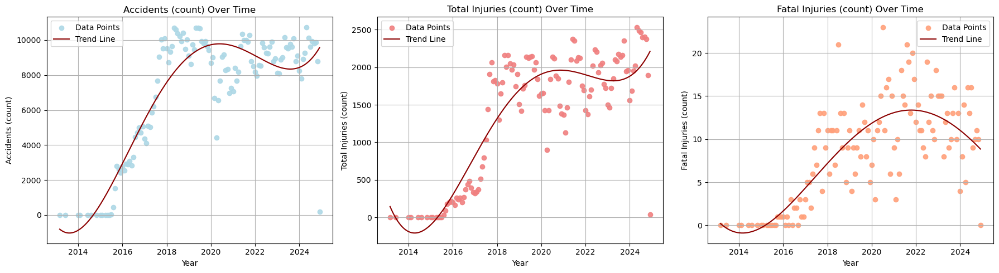

In [9]:
# Create YearMonth for grouping
crashes_df['YearMonth'] = crashes_df['CRASH_DATE'].dt.to_period('M')

# Aggregate data
crash_frequency = crashes_df.groupby('YearMonth').size()
injuries_total = crashes_df.groupby('YearMonth')['INJURIES_TOTAL'].sum()
injuries_fatal = crashes_df.groupby('YearMonth')['INJURIES_FATAL'].sum()

# Data to plot
data_dict = {
    'Accidents (count)': crash_frequency,
    'Total Injuries (count)': injuries_total,
    'Fatal Injuries (count)': injuries_fatal
}

colors = ['lightblue', 'lightcoral', 'lightsalmon']

# Set up the figure with three side-by-side subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 5), sharex=True)

for ax, ((title, data), color) in zip(axes, zip(data_dict.items(), colors)):
    # Scatter plot
    ax.scatter(data.index.to_timestamp(), 
               data.values, color=color, 
               label='Data Points', 
               alpha=0.9)
    
    # Polynomial trend line
    x_numeric = data.index.to_timestamp().astype(int) // 10**9  # Convert timestamp to numeric
    y_values = data.values
    coeffs = np.polyfit(x_numeric, y_values, 4)
    poly_eq = np.poly1d(coeffs)
    trend_x = np.linspace(x_numeric.min(), x_numeric.max(), 500)
    trend_y = poly_eq(trend_x)
    
    ax.plot(pd.to_datetime(trend_x, unit='s'), 
            trend_y, 
            color='darkred', 
            linestyle='-', 
            label='Trend Line')
    
    # Format plot
    ax.set_title(f'{title} Over Time')
    ax.set_xlabel('Year')
    ax.set_ylabel(title)
    ax.legend()
    ax.grid(True)

# Adjust layout
plt.tight_layout()
plt.show()


**Key Takeaways:**

* 2024 does not represent a full year worth of data, so data will represent 2024 only partially

* All three metrics (crash frequency, total injuries, and fatal injuries) exhibit a rise from 2014 to 2020, potentially influenced by factors such as increased traffic volume or better crash reporting

* The plateau or slight decline after 2020 across all metrics may suggest the impact of interventions

* The trend lines show a consistent polynomial shape, highlighting the growth and eventual stabilization phases over time


**Crash Frequency Over Time:**

Crash frequency exhibited a steady increase from 2014 to around 2020, reaching its peak. Post-2020, the trend appears to stabilize or slightly decline. This rise until 2020 might be attributed to factors such as urban growth, increased vehicle usage, or enhancements in data collection methodologies.


**Total Injuries Over Time:**

The trend in total injuries mirrors that of crash frequency, showing a rise from 2014 to 2020, followed by stabilization or a slight decline. This close correlation suggests that injury rates may be influenced by the number of crashes.


**Fatal Injuries Over Time:**

Fatal injuries also increased from 2014 to 2020 but at a slower rate compared to crash frequency and total injuries. After 2020, the trend appears to plateau.

#### Demographics (sex, age): indentity accidents' demographics


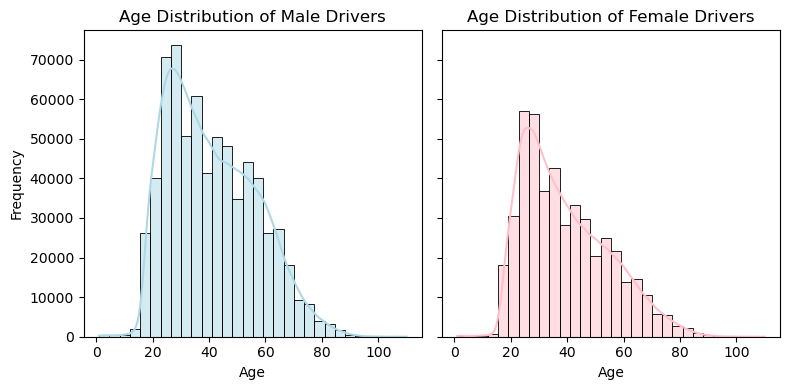

In [10]:
# Clean age data
people_df_cleaned = people_df.dropna(subset=['AGE', 'SEX', 'DRIVER_ACTION'])
people_df_cleaned = people_df_cleaned[people_df_cleaned['AGE'] > 0]

# Set up the figure with two side-by-side subplots
fig, axes = plt.subplots(1, 2, figsize=(8, 4), sharey=True)

# Distribution Plot for Age by Gender (Male)
sns.histplot(
    people_df_cleaned[people_df_cleaned['SEX'] == 'M']['AGE'],
    bins=30,
    kde=True,
    color='lightblue',
    ax=axes[0]
)
axes[0].set_title('Age Distribution of Male Drivers')
axes[0].set_xlabel('Age')
axes[0].set_ylabel('Frequency')

# Distribution Plot for Age by Gender (Female)
sns.histplot(
    people_df_cleaned[people_df_cleaned['SEX'] == 'F']['AGE'],
    bins=30,
    kde=True,
    color='pink',
    ax=axes[1]
)
axes[1].set_title('Age Distribution of Female Drivers')
axes[1].set_xlabel('Age')

# Adjust layout and display the plot
plt.tight_layout()
plt.show()


**Male Drivers' Age Distribution**

_Key Observations_:

* The distribution of male drivers involved in accidents is right-skewed, with the majority concentrated in the younger age groups.

* The peak is observed around the age range of 20–30 years, indicating that young male drivers are most frequently involved in accidents.

* The frequency decreases consistently beyond the age of 30, with very few accidents involving male drivers aged 60 and above.

* The decline in frequency for older age groups could reflect reduced driving activity or more cautious driving behavior.


**Female Drivers' Age Distribution**

_Key Observations_:

* The distribution of female drivers also exhibits a right-skewed pattern, but the peak frequency occurs slightly earlier, around the age range of 20–25 years.

* Similar to males, the frequency decreases steadily after the peak, with fewer accidents involving female drivers aged 50 and above.

* The tail for older age groups is less pronounced compared to males.

* The earlier decline in accidents for females might indicate reduced driving activity in older age groups or a higher propensity for cautious driving.


**Takeaway:**

The analysis reveals that younger drivers, particularly males aged 20–30, are at the highest risk of accidents, while older age groups pose significantly lower risks. This suggests insurers could implement higher premiums for younger drivers, especially males, while offering discounts for safe driving programs or vehicles with advanced safety features. Gender-adjusted pricing, usage-based insurance, and rewards for low-risk behaviors could help address these disparities.

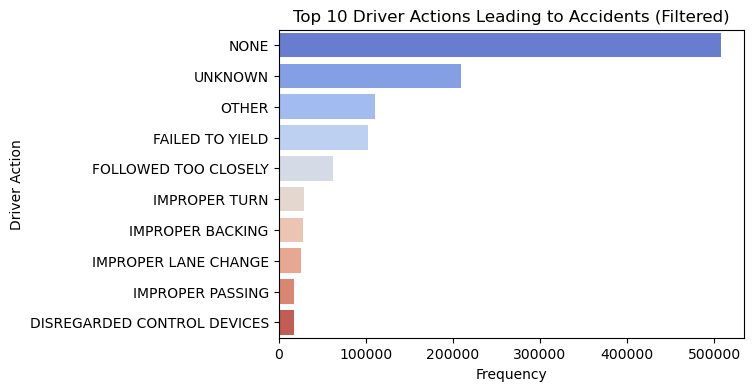

In [11]:
# Bar Plot for Top Driver Actions Causing Accidents
main_reason = people_df_cleaned['DRIVER_ACTION'].value_counts().head(10)

plt.figure(figsize=(6, 4))
sns.barplot(x=main_reason.values, y=main_reason.index, palette='coolwarm')
plt.title('Top 10 Driver Actions Leading to Accidents (Filtered)')
plt.xlabel('Frequency')
plt.ylabel('Driver Action')
plt.show()


The graph reveals that "Failed to Yield" is the most frequent driver action leading to accidents, followed by "Followed Too Closely,". These actions highlight an issue with non-compliance to traffic rules, such as yielding the right-of-way or maintaining safe following distances, which directly contribute to collisions. Additionally, improper driving behaviors like turning, backing, and lane changes also play a major role.

These findings suggest that risk modeling should heavily weigh these driver actions when assessing premiums and underwriting policies. Drivers with prior violations for these actions could be categorized as higher risk and charged higher premiums. By addressing these high-risk behaviors through both policy adjustments and incentives, the company can better manage claims costs.

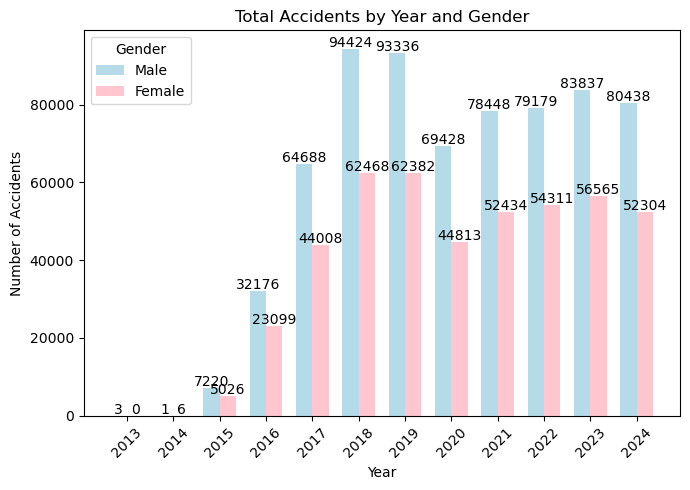

In [12]:
# Extract data for plotting
people_df_cleaned['CRASH_DATE'] = pd.to_datetime(people_df_cleaned['CRASH_DATE'])
people_df_cleaned['Year'] = people_df_cleaned['CRASH_DATE'].dt.year
accidents_by_year_gender = (people_df_cleaned.groupby(['Year', 'SEX']).size().unstack(fill_value=0).reset_index())
years = accidents_by_year_gender['Year'].values
y_male = accidents_by_year_gender.get('M', 0).values
y_female = accidents_by_year_gender.get('F', 0).values  

# Plotting the Bar Graph with total labels by genere (male and female)
plt.figure(figsize=(7, 5))
bar_width = 0.35

# Plot bars for Male and Female
plt.bar(years - bar_width / 2, y_male, width=bar_width, color='lightblue', label='Male', alpha=0.9)
plt.bar(years + bar_width / 2, y_female, width=bar_width, color='pink', label='Female', alpha=0.9)

# Add total labels for Male and Female above their respective bars
for i in range(len(years)):
    plt.text(years[i] - bar_width / 2, y_male[i] + 500, str(int(y_male[i])), ha='center', fontsize=10, color='black')
    plt.text(years[i] + bar_width / 2, y_female[i] + 500, str(int(y_female[i])), ha='center', fontsize=10, color='black')

# Customize the plot
plt.title('Total Accidents by Year and Gender')
plt.xlabel('Year')
plt.ylabel('Number of Accidents')
plt.xticks(years, rotation=45)
plt.legend(title='Gender', labels=['Male', 'Female'])
plt.tight_layout()
plt.show()


The graph shows that male drivers consistently account for more accidents than female drivers across all years, with the gap being most significant during the peak year of 2018.This disparity highlights a higher risk profile for male drivers, warranting targeted interventions and adjusted premiums for this demographic

This underscores the importance of gender-specific risk-based pricing, with higher premiums for male drivers in higher-risk categories. Stabilized accident rates in recent years also provide insurers with a more predictable risk environment, enabling more accurate pricing models.

#### Geographic Distribution of Crashes


In [37]:
def create_heatmap(df_loc, latitude, longitude, zoom=10, tiles='OpenStreetMap'):
    """
    Generate a Folium Map with a heatmap of accident locations.
    """
    # Ensure the dataframe contains only valid latitude and longitude values
    df_loc = df_loc.dropna(subset=['LATITUDE', 'LONGITUDE'])

    # Create a list of coordinates from the dataframe columns 'LATITUDE' and 'LONGITUDE'
    heat_data = [[row['LATITUDE'], row['LONGITUDE']] for index, row in df_loc.iterrows()]

    # Add attribution for the tiles
    tile_attribution = "Map tiles by Stamen Design, under CC BY 3.0. Data by OpenStreetMap, under ODbL."

    # Create a map centered around the specified coordinates
    heatmap = folium.Map(location=[latitude, longitude], zoom_start=zoom, tiles=tiles, attr=tile_attribution)

    # Adjust the HeatMap layer with lower intensity and more gradient classes
    HeatMap(heat_data, min_opacity=0.4, radius=10, blur=15, max_zoom=1, gradient={
        0.0: 'purple',
        0.1: 'blue',
        0.2: 'cyan',
        0.3: 'green',
        0.4: 'lime',
        0.5: 'yellow',
        0.6: 'orange',
        0.8: 'red',
        1.0: 'darkred'
    }).add_to(heatmap)

    return heatmap

# Chicago area
latitude = 41.8781
longitude = -87.6298
zoom = 11
# Generate heatmap
heatmap = create_heatmap(crashes_df, latitude, longitude, zoom)

# Display the heatmap
heatmap


The heatmap reveals the highest concentration of car accidents in Chicago's downtown core and surrounding areas like the Loop, Near North Side, and West Town, reflecting heavy traffic, dense intersections and urban congestion. 

Moderate accident densities extend westward into neighborhoods. Suburban areas show comparatively lower densities, highlighting less traffic intensity. These patterns suggest a strong link between traffic volume, urban density, and accident rates.

### Predictive Modeling and Risk Forecasting

**Goals:**

* Predicting severe accident propensity

* Develop risk profiles

**Full pipeline:**

1) Joining Data
2) Investigating Features
3) Feature Preparation
4) Model Training
5) Model Evaluation
6) Risk Profiling
7) Results and Conclusions


#### Joining Data

In [14]:
# Joining data
data = pd.merge(crashes_df, people_df, on='CRASH_RECORD_ID', how='inner')
data = data.drop(columns='CRASH_DATE_y').rename(columns={'CRASH_DATE_x': 'CRASH_DATE'})

# Generate unique record IDs to keep track of original rows
data['RECORD_ID'] = data.index

# Keep a copy of the original dataset
data_original = data.copy()

# Confirm RECORD_ID creation and display sample rows
data.head()


,CRASH_RECORD_ID,CRASH_DATE,POSTED_SPEED_LIMIT,TRAFFIC_CONTROL_DEVICE,DEVICE_CONDITION,WEATHER_CONDITION,LIGHTING_CONDITION,FIRST_CRASH_TYPE,TRAFFICWAY_TYPE,LANE_CNT,ALIGNMENT,ROADWAY_SURFACE_COND,ROAD_DEFECT,REPORT_TYPE,CRASH_TYPE,INTERSECTION_RELATED_I,HIT_AND_RUN_I,DAMAGE,DATE_POLICE_NOTIFIED,PRIM_CONTRIBUTORY_CAUSE,SEC_CONTRIBUTORY_CAUSE,STREET_NO,STREET_DIRECTION,STREET_NAME,BEAT_OF_OCCURRENCE,NUM_UNITS,MOST_SEVERE_INJURY,INJURIES_TOTAL,INJURIES_FATAL,INJURIES_INCAPACITATING,INJURIES_NON_INCAPACITATING,INJURIES_REPORTED_NOT_EVIDENT,INJURIES_NO_INDICATION,INJURIES_UNKNOWN,CRASH_HOUR,CRASH_DAY_OF_WEEK,CRASH_MONTH,LATITUDE,LONGITUDE,LOCATION,CRASH_DATE_FORMATTED,TIME_FORMATTED,YearMonth,PERSON_ID,PERSON_TYPE,VEHICLE_ID,SEAT_NO,CITY,STATE,ZIPCODE,SEX,AGE,DRIVERS_LICENSE_STATE,DRIVERS_LICENSE_CLASS,SAFETY_EQUIPMENT,AIRBAG_DEPLOYED,EJECTION,INJURY_CLASSIFICATION,HOSPITAL,EMS_AGENCY,EMS_RUN_NO,DRIVER_ACTION,DRIVER_VISION,PHYSICAL_CONDITION,PEDPEDAL_ACTION,PEDPEDAL_VISIBILITY,PEDPEDAL_LOCATION,BAC_RESULT,BAC_RESULT VALUE,CELL_PHONE_USE,RECORD_ID
0,23a79931ef555d54118f64dc9be2cf2dbf59636ce253f7...,2023-09-05 19:05:00,30,TRAFFIC SIGNAL,FUNCTIONING PROPERLY,CLEAR,DUSK,ANGLE,"FIVE POINT, OR MORE",NaN,STRAIGHT AND LEVEL,DRY,NO DEFECTS,ON SCENE,INJURY AND / OR TOW DUE TO CRASH,Y,NaN,"OVER $1,500",09/05/2023 07:05:00 PM,UNABLE TO DETERMINE,NOT APPLICABLE,5500,S,WENTWORTH AVE,225.0,2,INCAPACITATING INJURY,3.0,0.0,1.0,2.0,0.0,2.0,0.0,19,3,9,NaN,NaN,NaN,09/05/2023,19:05:00,2023-09,O1654630,DRIVER,1574687.0,NaN,DIXMOOR,IL,60426,M,51.0,IL,A,SAFETY BELT USED,"DEPLOYED, FRONT",NONE,NONINCAPACITATING INJURY,UNIVERSITY OF CHICAGO,CFD,NaN,NONE,UNKNOWN,NORMAL,NaN,NaN,NaN,TEST NOT OFFERED,NaN,NaN,0
1,23a79931ef555d54118f64dc9be2cf2dbf59636ce253f7...,2023-09-05 19:05:00,30,TRAFFIC SIGNAL,FUNCTIONING PROPERLY,CLEAR,DUSK,ANGLE,"FIVE POINT, OR MORE",NaN,STRAIGHT AND LEVEL,DRY,NO DEFECTS,ON SCENE,INJURY AND / OR TOW DUE TO CRASH,Y,NaN,"OVER $1,500",09/05/2023 07:05:00 PM,UNABLE TO DETERMINE,NOT APPLICABLE,5500,S,WENTWORTH AVE,225.0,2,INCAPACITATING INJURY,3.0,0.0,1.0,2.0,0.0,2.0,0.0,19,3,9,NaN,NaN,NaN,09/05/2023,19:05:00,2023-09,O1654631,DRIVER,1574690.0,NaN,CHICAGO,IL,60657,F,36.0,IL,D,SAFETY BELT USED,DID NOT DEPLOY,NONE,NO INDICATION OF INJURY,NaN,NaN,NaN,EMERGENCY VEHICLE ON CALL,UNKNOWN,NORMAL,NaN,NaN,NaN,TEST NOT OFFERED,NaN,NaN,1
2,23a79931ef555d54118f64dc9be2cf2dbf59636ce253f7...,2023-09-05 19:05:00,30,TRAFFIC SIGNAL,FUNCTIONING PROPERLY,CLEAR,DUSK,ANGLE,"FIVE POINT, OR MORE",NaN,STRAIGHT AND LEVEL,DRY,NO DEFECTS,ON SCENE,INJURY AND / OR TOW DUE TO CRASH,Y,NaN,"OVER $1,500",09/05/2023 07:05:00 PM,UNABLE TO DETERMINE,NOT APPLICABLE,5500,S,WENTWORTH AVE,225.0,2,INCAPACITATING INJURY,3.0,0.0,1.0,2.0,0.0,2.0,0.0,19,3,9,NaN,NaN,NaN,09/05/2023,19:05:00,2023-09,P366256,PASSENGER,1574690.0,7.0,CHICAGO,IL,60637,M,22.0,NaN,NaN,USAGE UNKNOWN,DID NOT DEPLOY,NONE,NONINCAPACITATING INJURY,UNIVERSITY OF CHICAGO,CFD,14,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2
3,23a79931ef555d54118f64dc9be2cf2dbf59636ce253f7...,2023-09-05 19:05:00,30,TRAFFIC SIGNAL,FUNCTIONING PROPERLY,CLEAR,DUSK,ANGLE,"FIVE POINT, OR MORE",NaN,STRAIGHT AND LEVEL,DRY,NO DEFECTS,ON SCENE,INJURY AND / OR TOW DUE TO CRASH,Y,NaN,"OVER $1,500",09/05/2023 07:05:00 PM,UNABLE TO DETERMINE,NOT APPLICABLE,5500,S,WENTWORTH AVE,225.0,2,INCAPACITATING INJURY,3.0,0.0,1.0,2.0,0.0,2.0,0.0,19,3,9,NaN,NaN,NaN,09/05/2023,19:05:00,2023-09,P366257,PASSENGER,1574690.0,7.0,CHCIAGO,IL,60653,M,55.0,NaN,NaN,USAGE UNKNOWN,DID NOT DEPLOY,NONE,INCAPACITATING INJURY,UNIVERSITY OF CHICAGO,CFD,38,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3
4,23a79931ef555d54118f64dc9be2cf2dbf59636ce253f7...,2023-09-05 19:05:00,30,TRAFFIC SIGNAL,FUNCTIONING PROPERLY,CLEAR,DUSK,ANGLE,"FIVE POINT, OR MORE",NaN,STRAIGHT AND LEVEL,DRY,NO DEFECTS,ON SCENE,INJURY AND / OR TOW DUE TO CRASH,Y,NaN,"OVER $1,500",09/05/2023 07:05:00 PM,UNABLE TO DETERMINE,NOT APPLICABLE,5500,S,WENTWORTH AVE,225.0,2,INCAPACITATING INJURY,3.0,0.0,1.0,2.0,0.0,2.0,0.0,19,3,9,NaN,NaN,N

#### Getting familiarized with the data

In [15]:
# Retrieving some dataset attributes
print(data.shape,'\n')

for column in data.columns:
    print(column)


(1972144, 71) 

CRASH_RECORD_ID
CRASH_DATE
POSTED_SPEED_LIMIT
TRAFFIC_CONTROL_DEVICE
DEVICE_CONDITION
WEATHER_CONDITION
LIGHTING_CONDITION
FIRST_CRASH_TYPE
TRAFFICWAY_TYPE
LANE_CNT
ALIGNMENT
ROADWAY_SURFACE_COND
ROAD_DEFECT
REPORT_TYPE
CRASH_TYPE
INTERSECTION_RELATED_I
HIT_AND_RUN_I
DAMAGE
DATE_POLICE_NOTIFIED
PRIM_CONTRIBUTORY_CAUSE
SEC_CONTRIBUTORY_CAUSE
STREET_NO
STREET_DIRECTION
STREET_NAME
BEAT_OF_OCCURRENCE
NUM_UNITS
MOST_SEVERE_INJURY
INJURIES_TOTAL
INJURIES_FATAL
INJURIES_INCAPACITATING
INJURIES_NON_INCAPACITATING
INJURIES_REPORTED_NOT_EVIDENT
INJURIES_NO_INDICATION
INJURIES_UNKNOWN
CRASH_HOUR
CRASH_DAY_OF_WEEK
CRASH_MONTH
LATITUDE
LONGITUDE
LOCATION
CRASH_DATE_FORMATTED
TIME_FORMATTED
YearMonth
PERSON_ID
PERSON_TYPE
VEHICLE_ID
SEAT_NO
CITY
STATE
ZIPCODE
SEX
AGE
DRIVERS_LICENSE_STATE
DRIVERS_LICENSE_CLASS
SAFETY_EQUIPMENT
AIRBAG_DEPLOYED
EJECTION
INJURY_CLASSIFICATION
HOSPITAL
EMS_AGENCY
EMS_RUN_NO
DRIVER_ACTION
DRIVER_VISION
PHYSICAL_CONDITION
PEDPEDAL_ACTION
PEDPEDAL_VISIBILI

#### Feature Preparation

##### Target Feature

We will derive a new variable `SEVERE_ACCIDENT_PRONE` as our target feature

This variable will be binary, indicating if the accident is prone or not to be severe

It will be defined by the following rule:

* `SEVERE_ACCIDENT_PRONE` = 1 if `INJURIES_INCAPACITATING` + `INJURIES_FATAL` > 1, and zero otherwise.
            
The target aggregates critical injury types into a single metric.

In [16]:
# Drop data
data = data.dropna(subset=['AGE', 'SEX'])

# Define severe injury
data['SEVERE_ACCIDENT_PRONE'] = (
    (data['INJURIES_INCAPACITATING'] + data['INJURIES_FATAL'] > 0).astype(int)
)

# Verify result
print(data['SEVERE_ACCIDENT_PRONE'].value_counts())


0    1357383
1      36150
Name: SEVERE_ACCIDENT_PRONE, dtype: int64


##### Feature Selection

* We will remove some of the features for dimensionality reduction purposes and speeding up training

In [17]:
# Drop most sparse features --> Threshold: more than 70% is NaN
missing_percentage = data.isna().sum().sort_values(ascending=False) / len(data) * 100
features_high_nan = missing_percentage[missing_percentage > 70].index.to_list()

# Drop high NaN
data = data.drop(columns=features_high_nan)

# Features dropped
for feature in features_high_nan:
    print(feature)

CELL_PHONE_USE
BAC_RESULT VALUE
EMS_RUN_NO
PEDPEDAL_VISIBILITY
PEDPEDAL_ACTION
PEDPEDAL_LOCATION
EMS_AGENCY
HIT_AND_RUN_I
SEAT_NO
HOSPITAL
LANE_CNT


##### Normalizing Numerical Features

In [18]:
# List of numerical variables
numerical_vars = data.select_dtypes(include=['number']).columns.difference(['SEVERE_ACCIDENT_PRONE', 'RECORD_ID']).to_list()

# Initialize scaler
scaler = StandardScaler()

# Scale numerical variables
data[numerical_vars] = scaler.fit_transform(data[numerical_vars])


##### Preparing Categorical Features

In [19]:
# Identify categorical variables
categorical_vars = data.select_dtypes(include=['object', 'category']).columns.to_list()

# Check the number of unique categories for each categorical variable
category_counts = data[categorical_vars].nunique()
print(category_counts.sort_values(ascending=False))


PERSON_ID                  1393533
CRASH_RECORD_ID             735975
DATE_POLICE_NOTIFIED        584926
LOCATION                    250089
ZIPCODE                      14508
CITY                         13385
CRASH_DATE_FORMATTED          3439
STREET_NAME                   1606
TIME_FORMATTED                1440
DRIVERS_LICENSE_CLASS          280
DRIVERS_LICENSE_STATE          209
STATE                           52
PRIM_CONTRIBUTORY_CAUSE         40
SEC_CONTRIBUTORY_CAUSE          40
TRAFFICWAY_TYPE                 20
DRIVER_ACTION                   20
SAFETY_EQUIPMENT                19
TRAFFIC_CONTROL_DEVICE          19
FIRST_CRASH_TYPE                18
DRIVER_VISION                   14
WEATHER_CONDITION               12
PHYSICAL_CONDITION              12
DEVICE_CONDITION                 8
ROADWAY_SURFACE_COND             7
ROAD_DEFECT                      7
AIRBAG_DEPLOYED                  7
LIGHTING_CONDITION               6
PERSON_TYPE                      6
ALIGNMENT           

In [20]:
# Drop a high-cardinality feature
high_cardinality_vars = category_counts[category_counts > 60].index.tolist()
data = data.drop(columns=high_cardinality_vars)
categorical_vars = [var for var in categorical_vars if var not in high_cardinality_vars]

In [21]:
# Initialize OneHotEncoder
encoder = OneHotEncoder(sparse=False, handle_unknown='ignore')

# Fit and transform categorical variables
encoded_categorical = encoder.fit_transform(data[categorical_vars])

# Convert encoded features to a DataFrame
encoded_categorical_df = pd.DataFrame(
    encoded_categorical, 
    columns=encoder.get_feature_names_out(categorical_vars),
    index=data.index
)


In [22]:
# Drop original categorical variables
data = data.drop(columns=categorical_vars)

# Concatenate numerical and encoded categorical variables
data = pd.concat([data, encoded_categorical_df], axis=1)


In [23]:
# Create features
X = data.drop(columns='SEVERE_ACCIDENT_PRONE')
record_ids = X['RECORD_ID']
X = X.drop(columns='RECORD_ID')
y = data['SEVERE_ACCIDENT_PRONE']


In [24]:
# Remove some other columns that are not helpful or cannot be used
columns_to_drop=['CRASH_DATE', 'POSTED_SPEED_LIMIT', 'STREET_NO', 'BEAT_OF_OCCURRENCE',
'NUM_UNITS', 'INJURIES_TOTAL', 'INJURIES_FATAL', 'INJURIES_INCAPACITATING', 'INJURIES_NON_INCAPACITATING', 
'INJURIES_REPORTED_NOT_EVIDENT', 'INJURIES_NO_INDICATION', 'INJURIES_UNKNOWN', 'LATITUDE', 'LONGITUDE', 
'YearMonth', 'VEHICLE_ID', 'FIRST_CRASH_TYPE_ANGLE', 'FIRST_CRASH_TYPE_ANIMAL', 'FIRST_CRASH_TYPE_FIXED OBJECT', 
'FIRST_CRASH_TYPE_HEAD ON', 'FIRST_CRASH_TYPE_OTHER NONCOLLISION', 'FIRST_CRASH_TYPE_OTHER OBJECT', 
'FIRST_CRASH_TYPE_OVERTURNED', 'FIRST_CRASH_TYPE_PARKED MOTOR VEHICLE', 'FIRST_CRASH_TYPE_PEDALCYCLIST', 
'FIRST_CRASH_TYPE_PEDESTRIAN', 'FIRST_CRASH_TYPE_REAR END', 'FIRST_CRASH_TYPE_REAR TO FRONT', 
'FIRST_CRASH_TYPE_REAR TO REAR', 'FIRST_CRASH_TYPE_REAR TO SIDE', 'FIRST_CRASH_TYPE_SIDESWIPE OPPOSITE DIRECTION', 
'FIRST_CRASH_TYPE_SIDESWIPE SAME DIRECTION', 'FIRST_CRASH_TYPE_TRAIN', 'FIRST_CRASH_TYPE_TURNING', 
'REPORT_TYPE_AMENDED', 
'REPORT_TYPE_NOT ON SCENE (DESK REPORT)', 
'REPORT_TYPE_ON SCENE', 
'REPORT_TYPE_nan', 
'CRASH_TYPE_INJURY AND / OR TOW DUE TO CRASH', 
'CRASH_TYPE_NO INJURY / DRIVE AWAY',                
'INTERSECTION_RELATED_I_nan', 
'DAMAGE_$500 OR LESS', 
'DAMAGE_$501 - $1,500', 
'DAMAGE_OVER $1,500', 
'STREET_DIRECTION_E', 
'STREET_DIRECTION_N', 
'STREET_DIRECTION_S', 
'STREET_DIRECTION_W', 
'STREET_DIRECTION_nan', 
'MOST_SEVERE_INJURY_FATAL', 
'MOST_SEVERE_INJURY_INCAPACITATING INJURY', 
'MOST_SEVERE_INJURY_NO INDICATION OF INJURY', 
'MOST_SEVERE_INJURY_NONINCAPACITATING INJURY', 
'MOST_SEVERE_INJURY_REPORTED, NOT EVIDENT', 
'SEX_X', 
'EJECTION_NONE', 
'EJECTION_PARTIALLY EJECTED', 
'EJECTION_TOTALLY EJECTED', 
'EJECTION_TRAPPED/EXTRICATED', 
'EJECTION_UNKNOWN', 
'EJECTION_nan', 
'INJURY_CLASSIFICATION_FATAL', 
'INJURY_CLASSIFICATION_INCAPACITATING INJURY', 
'INJURY_CLASSIFICATION_NO INDICATION OF INJURY', 
'INJURY_CLASSIFICATION_NONINCAPACITATING INJURY', 
'INJURY_CLASSIFICATION_REPORTED, NOT EVIDENT', 
'INJURY_CLASSIFICATION_nan', 
'BAC_RESULT_TEST NOT OFFERED', 
'BAC_RESULT_TEST PERFORMED, RESULTS UNKNOWN', 
'BAC_RESULT_TEST REFUSED', 
'BAC_RESULT_TEST TAKEN', 
'BAC_RESULT_nan']
 
#  # Drop columns in batches
for i in range(0, len(columns_to_drop), 12):  
    batch = columns_to_drop[i:i+12]
    X = X.drop(columns=batch)


#### Model Training

In [25]:
# Split the data
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
X_train, X_test, y_train, y_test, record_ids_train, record_ids_test = train_test_split(X, y, record_ids, test_size=0.3, random_state=42)


In [26]:
# Train a logistic regression model
lr_model = LogisticRegression(max_iter=1000)
lr_model.fit(X_train, y_train)


LogisticRegression(max_iter=1000)

In [27]:
# Train a decision tree
dt_model = DecisionTreeClassifier()
dt_model.fit(X_train, y_train)

DecisionTreeClassifier()

In [28]:
# Train a random forest
rf_model = RandomForestClassifier(n_estimators=100)
rf_model.fit(X_train, y_train)

RandomForestClassifier()

#### Model Evaluation

**Creating Predictions**

In [29]:
# Model predictions
lr_pred = lr_model.predict(X_test)
dt_pred = dt_model.predict(X_test)
rf_pred = rf_model.predict(X_test)


**Evaluate models**


In [30]:
# Logistic Regression Report
print("Logistic Regression Report")
print(classification_report(y_test, lr_pred))

# Decision Tree Report
print("Decision Tree Report")
print(classification_report(y_test, dt_pred))

# Random Forest Report
print("Random Forest Report")
print(classification_report(y_test, rf_pred))


Logistic Regression Report
              precision    recall  f1-score   support

           0       0.97      1.00      0.99    407257
           1       0.37      0.01      0.02     10803

    accuracy                           0.97    418060
   macro avg       0.67      0.51      0.50    418060
weighted avg       0.96      0.97      0.96    418060

Decision Tree Report
              precision    recall  f1-score   support

           0       0.98      0.97      0.98    407257
           1       0.19      0.23      0.21     10803

    accuracy                           0.95    418060
   macro avg       0.58      0.60      0.59    418060
weighted avg       0.96      0.95      0.96    418060

Random Forest Report
              precision    recall  f1-score   support

           0       0.98      1.00      0.99    407257
           1       0.95      0.08      0.15     10803

    accuracy                           0.98    418060
   macro avg       0.96      0.54      0.57    418060
weigh

**Model Evaluation**

The performance metrics reveal challenges in predicting the minority class across Logistic Regression, Decision Tree, and Random Forest models, despite strong accuracy dominated by the majority class. Logistic Regression struggles most with the minority class, achieving only 0.01 recall, while Decision Tree improves recall to 0.23 with a balanced F1-score but sacrifices some overall accuracy. Random Forest achieves high precision (0.95) but poor recall (0.08), resulting in a low F1-score. The Random Forest model, however, still outperforms the others overall.

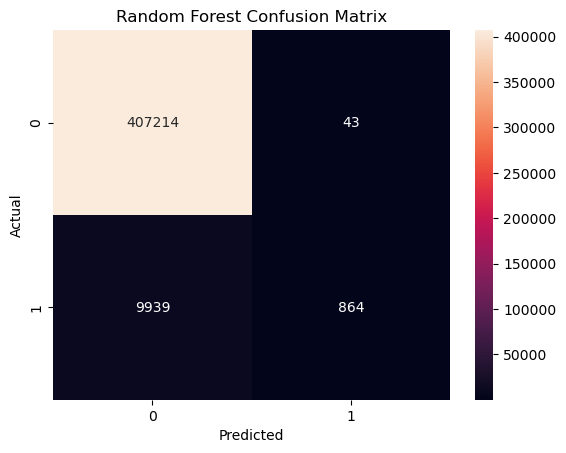

In [31]:
# Confusion Matrix for random forest model
conf_mat = confusion_matrix(y_test, rf_pred)
sns.heatmap(conf_mat, annot=True, fmt='d')
plt.title('Random Forest Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()


The confusion matrix for the Random Forest model highlights its strong performance for the majority class (0), with high precision and minimal false positives, but significant struggles with the minority class (1), where low recall reveals most positive cases are missed. This class imbalance leads to high overall accuracy but poor detection of the minority class, emphasizing the need for techniques like oversampling, undersampling, or class weighting to improve minority class predictions.

In [ ]:
# Initialize a AUC scores dictionary
auc_scores = {}

# Logistic Regression
lr_probs = lr_model.predict_proba(X_test)[:, 1]
auc_scores['Logistic Regression'] = roc_auc_score(y_test, lr_probs)

# Decision Tree
dt_probs = dt_model.predict_proba(X_test)[:, 1]
auc_scores['Decision Tree'] = roc_auc_score(y_test, dt_probs)

# Random Forest
rf_probs = rf_model.predict_proba(X_test)[:, 1]
auc_scores['Random Forest'] = roc_auc_score(y_test, rf_probs)

# Check AUC scores
auc_scores


{'Logistic Regression': 0.8066039203704216,
 'Decision Tree': 0.6029109463480493,
 'Random Forest': 0.8375426669241912}

The AUC scores show Random Forest as the best-performing model (0.838), demonstrating strong discriminatory ability, followed by Logistic Regression (0.807), which offers a simpler yet moderately accurate alternative. The Decision Tree performs poorly with an AUC of 0.603, struggling to differentiate between classes, highlighting the need for tuning or more advanced approaches.

**Select the Best Model**

* **Evaluation metrics:** precision, recall, F1-score and AUC score overall

* **Best Model:** Random Forest


#### Risk Profiling

**Goal:** Classify drivers into risk groups based on their propensity for severe accidents, enabling targeted interventions and improved risk management strategies.

**Merging back to keep track of records by their ids**

In [33]:
# Calculate propensity scores for all records
X['PROPENSITY_SCORE'] = rf_model.predict_proba(X)[:, 1]

# Reattach RECORD_ID After Predictions
X['RECORD_ID'] = data_original['RECORD_ID']


In [34]:
# Merge PROPENSITY_SCORE back into the original dataset
data_final = pd.merge(data_original, 
                      X[['RECORD_ID', 'PROPENSITY_SCORE']], 
                      on='RECORD_ID', 
                      how='left')


In [35]:
# Define risk thresholds
def assign_risk_group(score):
    if score >= 0.7:
        return 'High Risk'
    elif score >= 0.4:
        return 'Medium Risk'
    else:
        return 'Low Risk'

data_final['RISK_GROUP'] = data_final['PROPENSITY_SCORE'].apply(assign_risk_group)



 =================================== High Risk ===================================


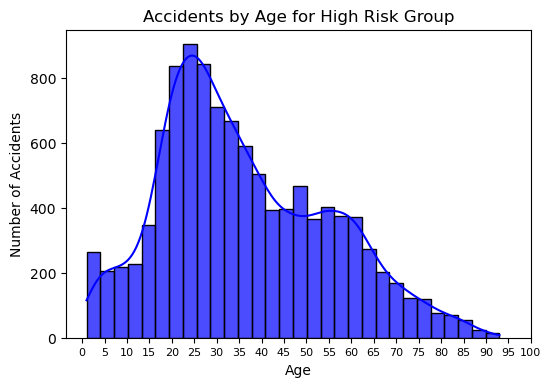

Sex Distribution:
M    0.576179
F    0.422163
X    0.001658
Name: SEX, dtype: float64

Top Primary Contributory Causes:
UNABLE TO DETERMINE                                                                 2542
FAILING TO YIELD RIGHT-OF-WAY                                                       1978
DISREGARDING TRAFFIC SIGNALS                                                        1086
FAILING TO REDUCE SPEED TO AVOID CRASH                                               925
OPERATING VEHICLE IN ERRATIC, RECKLESS, CARELESS, NEGLIGENT OR AGGRESSIVE MANNER     424
Name: PRIM_CONTRIBUTORY_CAUSE, dtype: int64

Top Secondary Contributory Causes:
NOT APPLICABLE                            3526
UNABLE TO DETERMINE                       3045
FAILING TO REDUCE SPEED TO AVOID CRASH     895
FAILING TO YIELD RIGHT-OF-WAY              642
DRIVING SKILLS/KNOWLEDGE/EXPERIENCE        387
Name: SEC_CONTRIBUTORY_CAUSE, dtype: int64


 =================================== Medium Risk ==========================

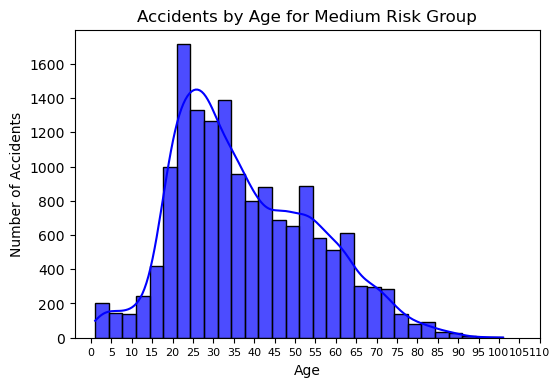

Sex Distribution:
M    0.591842
F    0.405481
X    0.002677
Name: SEX, dtype: float64

Top Primary Contributory Causes:
UNABLE TO DETERMINE                       4125
FAILING TO YIELD RIGHT-OF-WAY             3191
DISREGARDING TRAFFIC SIGNALS              1222
FAILING TO REDUCE SPEED TO AVOID CRASH    1221
FOLLOWING TOO CLOSELY                      836
Name: PRIM_CONTRIBUTORY_CAUSE, dtype: int64

Top Secondary Contributory Causes:
NOT APPLICABLE                            5697
UNABLE TO DETERMINE                       4759
FAILING TO REDUCE SPEED TO AVOID CRASH    1081
FAILING TO YIELD RIGHT-OF-WAY              921
DRIVING SKILLS/KNOWLEDGE/EXPERIENCE        523
Name: SEC_CONTRIBUTORY_CAUSE, dtype: int64


 =================================== Low Risk ===================================


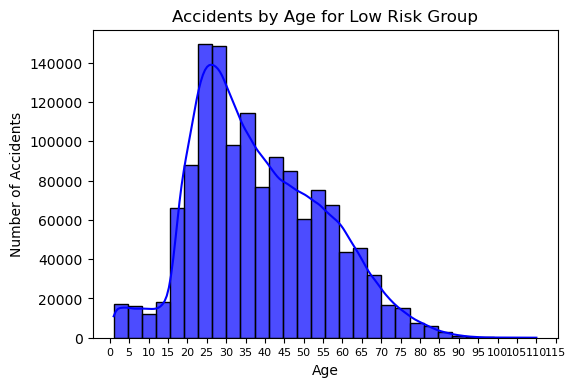

Sex Distribution:
M    0.573330
F    0.425252
X    0.001418
Name: SEX, dtype: float64

Top Primary Contributory Causes:
UNABLE TO DETERMINE                       422190
FAILING TO YIELD RIGHT-OF-WAY             196715
FOLLOWING TOO CLOSELY                     163928
IMPROPER OVERTAKING/PASSING                72130
FAILING TO REDUCE SPEED TO AVOID CRASH     70159
Name: PRIM_CONTRIBUTORY_CAUSE, dtype: int64

Top Secondary Contributory Causes:
NOT APPLICABLE                            541648
UNABLE TO DETERMINE                       447095
FAILING TO REDUCE SPEED TO AVOID CRASH     60464
FAILING TO YIELD RIGHT-OF-WAY              56493
DRIVING SKILLS/KNOWLEDGE/EXPERIENCE        48301
Name: SEC_CONTRIBUTORY_CAUSE, dtype: int64



In [43]:
# Ensure data_final is filtered to include only valid ages
data_final = data_final[data_final['AGE'] > 0]

# Risk groups to analyze
risk_groups = ['High Risk', 'Medium Risk', 'Low Risk']

# Loop through each risk group to plot age distributions and analyze other features
for group in risk_groups:
    group_data = data_final[data_final['RISK_GROUP'] == group]
    
    print("\n", 35 * "=", f'{group}', 35 * "=")
    
    # Distribution Plot for Age
    plt.figure(figsize=(6, 4))
    sns.histplot(group_data['AGE'], bins=30, kde=True, color='blue', alpha=0.7)
    plt.title(f'Accidents by Age for {group} Group')
    plt.xlabel('Age')
    plt.ylabel('Number of Accidents')
    plt.xticks(ticks=range(0, int(group_data['AGE'].max()) + 10, 5), fontsize=8)
    plt.show()
    
    # Analyze Sex Distribution
    print("Sex Distribution:")
    print(group_data['SEX'].value_counts(normalize=True))
    
    # Analyze Primary Contributory Causes
    print("\nTop Primary Contributory Causes:")
    print(group_data['PRIM_CONTRIBUTORY_CAUSE'].value_counts().head())
    
    # Analyze Secondary Contributory Causes
    print("\nTop Secondary Contributory Causes:")
    print(group_data['SEC_CONTRIBUTORY_CAUSE'].value_counts().head())
    print("\n", 80 * "=")


#### Conclusions

* Trends in Crashes: From 2014 to 2020, crashes, injuries, and fatalities increased but plateaued in recent years.

* High-Risk Groups: Younger male drivers (20–30 years) dominate high-risk accidents due to behavioral tendencies, while females are less involved overall.

* Risk Insights: High-risk drivers are predominantly young males exhibiting risky behaviors, leading to severe accidents. Low-risk drivers align with general population trends, with minimal violations and mostly minor accidents.

* Causes of Accidents: Systemic issues like failing to yield and disregarding signals are leading contributors across risk groups.

* Implications: Emphasizes risk-based pricing, tailored premiums for high-risk groups, and incentives for safer driving.


***
**End**
***